Importing Libraries

In [46]:
import tensorflow as tflow
import matplotlib.pyplot as plot
import pandas
import seaborn

Data Preprocessing

In [47]:
# Training Image Preprocessing
training_set = tflow.keras.utils.image_dataset_from_directory(
    "train",
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False,
    pad_to_aspect_ratio=False,
    format="tf",
    verbose=True,
)


Found 70295 files belonging to 38 classes.


Validate Data Preprocessing

In [48]:
# Training Image Preprocessing
validation_set = tflow.keras.utils.image_dataset_from_directory(
    "valid",
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False,
    pad_to_aspect_ratio=False,
    format="tf",
    verbose=True,
)


Found 17117 files belonging to 38 classes.


In [49]:
for x, y in training_set:
    print(x, x.shape)
    print(y, y.shape)

tf.Tensor(
[[[[165.25 146.25 131.25]
   [160.   141.   126.  ]
   [160.75 141.75 126.75]
   ...
   [174.   157.   147.  ]
   [185.25 168.25 158.25]
   [175.25 158.25 148.25]]

  [[161.   142.   127.  ]
   [155.   136.   121.  ]
   [151.25 132.25 117.25]
   ...
   [185.5  168.5  158.5 ]
   [180.75 163.75 153.75]
   [182.5  165.5  155.5 ]]

  [[160.25 141.25 126.25]
   [155.5  136.5  121.5 ]
   [159.   140.   125.  ]
   ...
   [182.25 165.25 155.25]
   [182.5  165.5  155.5 ]
   [172.25 155.25 145.25]]

  ...

  [[160.75 142.75 132.75]
   [167.   149.   139.  ]
   [167.25 149.25 139.25]
   ...
   [177.   164.   156.  ]
   [177.25 164.25 156.25]
   [184.5  171.5  163.5 ]]

  [[175.25 157.25 147.25]
   [156.   138.   128.  ]
   [165.75 147.75 137.75]
   ...
   [181.25 168.25 160.25]
   [175.5  162.5  154.5 ]
   [174.5  161.5  153.5 ]]

  [[153.75 135.75 125.75]
   [152.   134.   124.  ]
   [159.5  141.5  131.5 ]
   ...
   [187.25 174.25 166.25]
   [177.75 164.75 156.75]
   [177.   164.   15

Building Model

In [50]:
from tensorflow.keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout
from tensorflow.keras.models import Sequential

model = Sequential()
 

In [51]:
# Convolution Layer
model.add(Conv2D(filters=32, kernel_size=3, padding= "same", activation= "relu", input_shape=[128, 128, 3]))   # why 32? What if I increase the amount? What if my kernel size is smaller or bigger than 3?
model.add(Conv2D(filters=32, kernel_size=3, activation= "relu"))
model.add(MaxPool2D(pool_size=2, strides=2))

/home/tahsinttalha/MLcode/venv/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [52]:
# 2nd Convolution Layer
model.add(Conv2D(filters=64, kernel_size=3, padding= "same", activation= "relu"))
model.add(Conv2D(filters=64, kernel_size=3, activation= "relu"))
model.add(MaxPool2D(pool_size=2, strides=2))

In [53]:
# 3rd Covolution Layer
model.add(Conv2D(filters=128, kernel_size=3, padding= "same", activation= "relu"))
model.add(Conv2D(filters=128, kernel_size=3, activation= "relu"))
model.add(MaxPool2D(pool_size=2, strides=2))

In [54]:
# 4th Convolution Layer
model.add(Conv2D(filters=256, kernel_size=3, padding= "same", activation= "relu"))
model.add(Conv2D(filters=256, kernel_size=3, activation= "relu"))
model.add(MaxPool2D(pool_size=2, strides=2))

In [55]:
# 5th Convolution Layer
model.add(Conv2D(filters=512, kernel_size=3, padding= "same", activation= "relu"))
model.add(Conv2D(filters=512, kernel_size=3, activation= "relu"))
model.add(MaxPool2D(pool_size=2, strides=2))

In [56]:
model.add(Flatten())
model.add(Dense(units=1500, activation="relu"))
model.add(Dropout(0.4)) #To avoid overfitting

# output layer
model.add(Dense(units=38, activation="softmax"))

Compiling Model

In [57]:
model.compile(optimizer=tflow.keras.optimizers.Adam(learning_rate=0.0001), loss="categorical_crossentropy", metrics=["accuracy"])
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_29 (Conv2D)              │ (None, 128, 128, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 126, 126, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 63, 63, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_32 (Conv2D)              │ (None, 61, 61, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 30, 30, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 28, 28, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 14, 14, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 14, 14, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_36 (Conv2D)              │ (None, 12, 12, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 6, 6, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 6, 6, 512)      │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 4, 4, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 2, 2, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 1500)           │     3,073,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1500)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 38)             │        57,038 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,842,762 (29.92 MB)

 Trainable params: 7,842,762 (29.92 MB)

 Non-trainable params: 0 (0.00 B)

Training Model

In [58]:
training_history = model.fit(x=training_set, validation_data=validation_set, epochs=10)

Epoch 1/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - accuracy: 0.4614 - loss: 1.8939

2026-02-03 15:03:22.226197: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_234', 8 bytes spill stores, 8 bytes spill loads

2026-02-03 15:03:22.709710: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_234', 56 bytes spill stores, 56 bytes spill loads



2197/2197 ━━━━━━━━━━━━━━━━━━━━ 233s 98ms/step - accuracy: 0.6481 - loss: 1.1837 - val_accuracy: 0.8699 - val_loss: 0.4229
Epoch 2/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 203s 92ms/step - accuracy: 0.8768 - loss: 0.3830 - val_accuracy: 0.9093 - val_loss: 0.2795
Epoch 3/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 205s 93ms/step - accuracy: 0.9239 - loss: 0.2351 - val_accuracy: 0.9319 - val_loss: 0.2083
Epoch 4/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 201s 91ms/step - accuracy: 0.9471 - loss: 0.1599 - val_accuracy: 0.9345 - val_loss: 0.1954
Epoch 5/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 205s 93ms/step - accuracy: 0.9616 - loss: 0.1159 - val_accuracy: 0.9454 - val_loss: 0.1729
Epoch 6/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 201s 91ms/step - accuracy: 0.9707 - loss: 0.0913 - val_accuracy: 0.9615 - val_loss: 0.1234
Epoch 7/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 200s 91ms/step - accuracy: 0.9738 - loss: 0.0795 - val_accuracy: 0.9393 - val_loss: 0.2057
Epoch 8/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 200s 90ms/step - accuracy: 0.9792 - lo

In [60]:
model.save('plant_disease_model.h5')
model.save('plant_disease_model.keras')

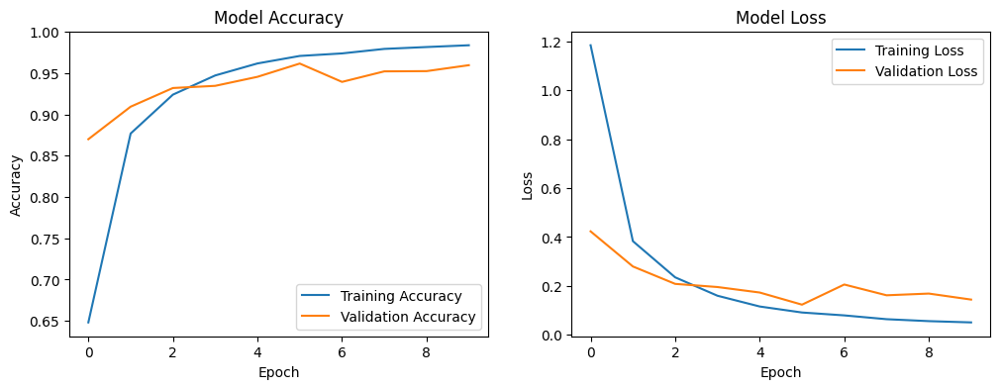

In [62]:
plot.figure(figsize=(12, 4))
   
plot.subplot(1, 2, 1)
plot.plot(training_history.history['accuracy'], label='Training Accuracy')
plot.plot(training_history.history['val_accuracy'], label='Validation Accuracy')
plot.xlabel('Epoch')
plot.ylabel('Accuracy')
plot.legend()
plot.title('Model Accuracy')

plot.subplot(1, 2, 2)
plot.plot(training_history.history['loss'], label='Training Loss')
plot.plot(training_history.history['val_loss'], label='Validation Loss')
plot.xlabel('Epoch')
plot.ylabel('Loss')
plot.legend()
plot.title('Model Loss')

plot.show()